### 1. Dr. Cristiano Wrasse and I have been working on a small experiment to monitor Embrace's aeroluminescence laboratories. 

### This experiment is capable of monitoring temperature, humidity and luminosity in a given laboratory. In addition, it calculates the elevations of the Sun and Moon and, based on these elevations, the observations are initiated (ended) through the activation (shutdown) of 4 relays. 

### Observations are made only when the elevation of the Sun and Moon is less than -12° and 10°, respectively. 
### Make a script to read the data from this experiment and plot a graph like the one shown below. The observation period is represented by the hatched area

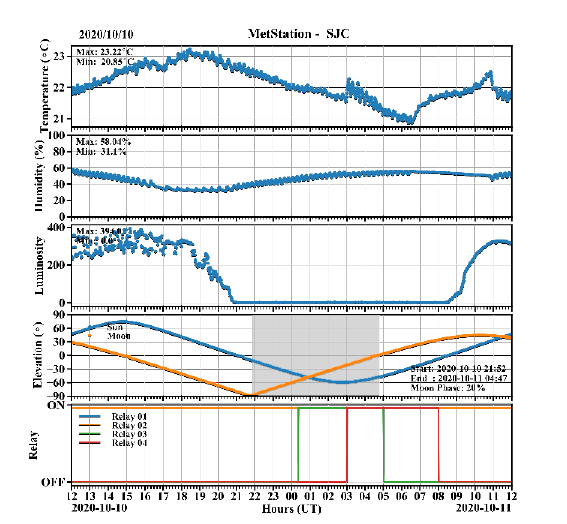

In [1]:
import pyqtgraph as pg

pip install pyqtgraph

In [2]:
import pyspedas

In [3]:
import pandas as pd
# Handle date time conversions between pandas and matplotlib
from pandas.plotting import register_matplotlib_converters
register_matplotlib_converters()


In [4]:
from pytplot import get_data,store_data, timebar,tplot, tplot_names
import matplotlib.pyplot as plt
params = {'tex.usetex': True}

import numpy as np
import matplotlib.dates as md
import pandas as pd

from datetime import datetime
from matplotlib.colors import LogNorm
from matplotlib import dates


In [5]:
headers = ['Date', 'Hour(UTC)', 'Julian Hour', 'Temperature(⁰C)', 'Humidity(%)', 'LDR', 'Relay 01', 'Relay 02',\
         'Relay 03', 'Relay 04', 'Sun(⁰)', 'Moon(⁰)']

In [6]:
df = pd.read_csv('Q1teste.txt', sep='\s+', names=headers, parse_dates=['Date'])
df = pd.DataFrame(df)
df

,Date,Hour(UTC),Julian Hour,Temperature(⁰C),Humidity(%),LDR,Relay 01,Relay 02,Relay 03,Relay 04,Sun(⁰),Moon(⁰)
0,10102020,120042,2.459133e+06,21.76,55.39,244,1.0,1.0,0.0,0.0,47.05,28.91
1,10102020,120142,2.459133e+06,21.81,56.30,230,1.0,1.0,0.0,0.0,47.27,28.76
2,10102020,120242,2.459133e+06,21.85,56.72,238,1.0,1.0,0.0,0.0,47.50,28.61
3,10102020,120342,2.459133e+06,21.90,57.22,238,1.0,1.0,0.0,0.0,47.72,28.46
4,10102020,120442,2.459133e+06,21.95,57.77,356,1.0,1.0,0.0,0.0,47.94,28.31
...,...,...,...,...,...,...,...,...,...,...,...,...
1430,11102020,115501,2.459133e+06,21.85,53.50,321,1.0,1.0,0.0,0.0,46.00,38.41
1431,11102020,115601,2.459133e+06,21.84,52.33,313,1.0,1.0,0.0,0.0,46.23,38.30
1432,11102020,115701,2.459133e+06,21.81,51.05,313,1.0,1.0,0.0,0.0,46.45,38.18
1433,11102020,115801,2.459133e+06,21.75,49.77,313,1.0,1.0,0.0,0.0,46.68,38.07


In [6]:
df = pd.read_csv('Q1teste.txt', sep='\s+', names=headers, parse_dates=['Date'])
df = pd.DataFrame(df)

df['Date'] = pd.to_datetime(df['Date'], format='%d%m%Y')
df['Hour(UTC)'] = (pd.to_datetime(df['Hour(UTC)'].astype(str).str.zfill(4), format='%H%M%S')\
                   - pd.to_datetime('1900-01-01') +  pd.to_datetime(df['Date']))
#df = df.set_index('Hour(UTC)')

#df['Julian Hour'] = pd.to_datetime(df['Julian Hour'] - pd.Timestamp(0).to_julian_date(), unit='D')
#df['Hour(UTC)'] = pd.to_datetime(df['Hour(UTC)'], format='%H%M%S')
df

,Date,Hour(UTC),Julian Hour,Temperature(⁰C),Humidity(%),LDR,Relay 01,Relay 02,Relay 03,Relay 04,Sun(⁰),Moon(⁰)
0,2020-10-10,2020-10-10 12:00:42,2.459133e+06,21.76,55.39,244,1.0,1.0,0.0,0.0,47.05,28.91
1,2020-10-10,2020-10-10 12:01:42,2.459133e+06,21.81,56.30,230,1.0,1.0,0.0,0.0,47.27,28.76
2,2020-10-10,2020-10-10 12:02:42,2.459133e+06,21.85,56.72,238,1.0,1.0,0.0,0.0,47.50,28.61
3,2020-10-10,2020-10-10 12:03:42,2.459133e+06,21.90,57.22,238,1.0,1.0,0.0,0.0,47.72,28.46
4,2020-10-10,2020-10-10 12:04:42,2.459133e+06,21.95,57.77,356,1.0,1.0,0.0,0.0,47.94,28.31
...,...,...,...,...,...,...,...,...,...,...,...,...
1430,2020-10-11,2020-10-11 11:55:01,2.459133e+06,21.85,53.50,321,1.0,1.0,0.0,0.0,46.00,38.41
1431,2020-10-11,2020-10-11 11:56:01,2.459133e+06,21.84,52.33,313,1.0,1.0,0.0,0.0,46.23,38.30
1432,2020-10-11,2020-10-11 11:57:01,2.459133e+06,21.81,51.05,313,1.0,1.0,0.0,0.0,46.45,38.18
1433,2020-10-11,2020-10-11 11:58:01,2.459133e+06,21.75,49.77,313,1.0,1.0,0.0,0.0,46.68,38.07


In [7]:
df.dtypes

Date               datetime64[ns]
Hour(UTC)          datetime64[ns]
Julian Hour               float64
Temperature(⁰C)           float64
Humidity(%)               float64
LDR                         int64
Relay 01                  float64
Relay 02                  float64
Relay 03                  float64
Relay 04                  float64
Sun(⁰)                    float64
Moon(⁰)                   float64
dtype: object

17-nov-21 00:37:25: /tmp/ipykernel_51314/3214864270.py:89: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  fig.tight_layout()



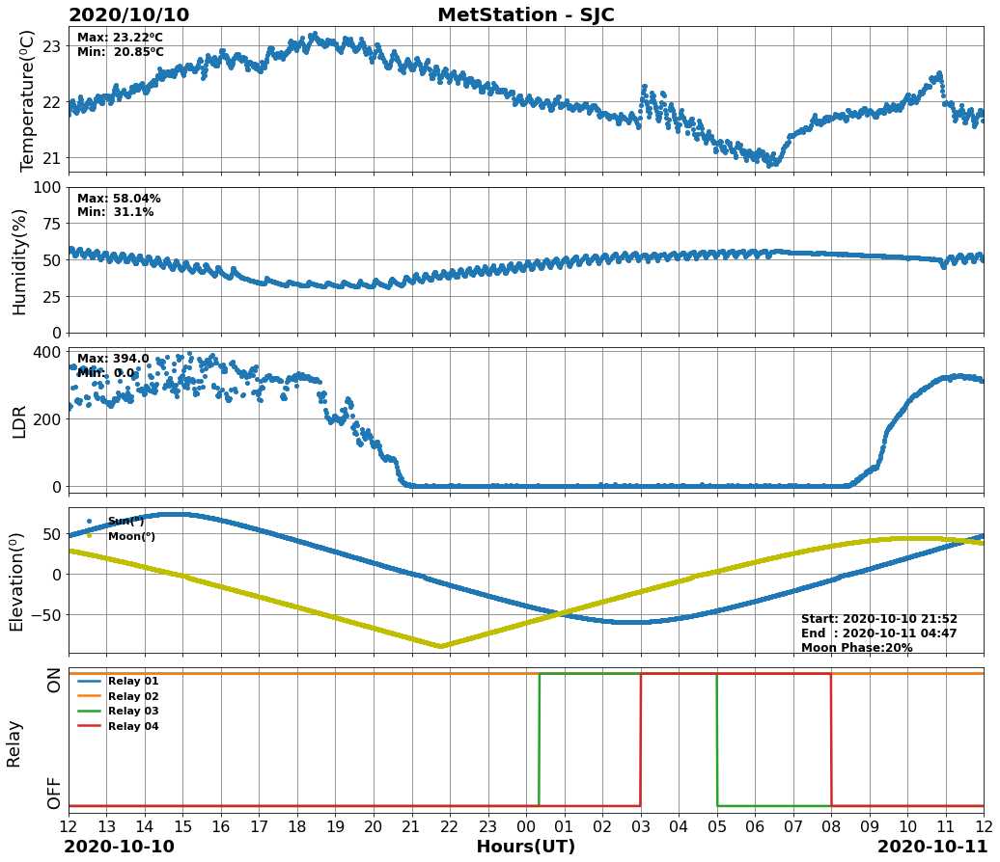

In [8]:
fig, ax = plt.subplots(5, figsize=(17,15), gridspec_kw={'hspace': 0.10}, sharex=True, sharey=False)
ax[0].set_title('MetStation - SJC', size=20, weight='bold')
ax[0].set_title('2020/10/10', loc='left', size=20, weight='bold')
#ax[4].text(center, bottom, '2020/10/10', horizontalalignment='right', verticalalignment='bottom',\
plt.xlabel('2020-10-10'+50*' '+'Hours(UT)'+50*' '+'2020-10-11', size=18, weight='bold')

plt.rcParams['figure.figsize'] = [12,12]
plt.rcParams["font.weight"] = "bold"

#fontdict={'fontsize': 22,
#           'weight' : 'bold'}

#fontdicty={'fontsize': 25,
#           'weight' : 'bold'}

#fontdictx={'fontsize': 25,
#           'weight' : 'bold'}


# #Date formatting
# days = dates.DayLocator(interval=1)
# dft = dates.DateFormatter('%d')
# #Time formatting
# hours = dates.HourLocator(byhour=range(0,24,1))
# hft = dates.DateFormatter('%H')

#Plot 1
ax[0].plot(df['Temperature(⁰C)'], 'o', markersize=4)
ax[0].set_ylabel('Temperature(⁰C)', size=18)
ax[0].annotate('Max: 23.22⁰C \nMin:  20.85⁰C', xy=(0.01, 0.80), xycoords='axes fraction', size=12)

#Plot 2
ax[1].plot(df['Humidity(%)'], 'o', markersize=4)
ax[1].set_ylabel('Humidity(%)', size=18)
ax[1].set_ylim(0,100)

ax[1].annotate('Max: 58.04% \nMin:  31.1%', xy=(0.01, 0.80), xycoords='axes fraction', size=12)

#Plot 3
ax[2].plot(df['LDR'], 'o', linewidth=2, markersize=4)
ax[2].set_ylabel('LDR', size=18)
ax[2].annotate('Max: 394.0 \nMin:  0.0', xy=(0.01, 0.80), xycoords='axes fraction', size=12)

#Plot 4
ax[3].plot(df['Sun(⁰)'], 'o', label='Sun(⁰)', markersize=4)
ax[3].plot(df['Moon(⁰)'], 'yo', label='Moon(⁰)', markersize=4)
ax[3].set_ylabel('Elevation(⁰)', size=18)
ax[3].annotate('Start: 2020-10-10 21:52 \nEnd  : 2020-10-11 04:47 \nMoon Phase:20%',
               xy=(0.8, 0.01),
               xycoords='axes fraction',
               size=12
              )
ax[3].legend(loc='upper left', fontsize=11, frameon=False)

#Plot 5
ax[4].plot(df['Relay 01'], label='Relay 01', linewidth=2.5)
ax[4].plot(df['Relay 02'], label='Relay 02', linewidth=2.5)
ax[4].plot(df['Relay 03'], label='Relay 03', linewidth=2.5)
ax[4].plot(df['Relay 04'], label='Relay 04', linewidth=2.5)
ax[4].set_ylabel('Relay \n\n OFF'+15*' '+'ON', size=18)
ax[4].set_yticks([])
ax[4].legend(loc='upper left', fontsize=11, frameon=False)

ax[4].set_xticks(np.linspace(0, 1436, 25))
labels = [item.get_text() for item in ax[4].get_xticklabels()]
labels =['12', '13', '14', '15', '16', '17', '18', '19', '20', '21', '22',\
          '23', '00','01', '02', '03', '04', '05', '06', '07', '08', '09', '10', '11', '12']

ax[4].set_xticklabels(labels)

for axis in ax:
#     axis.xaxis.set_major_locator(hours)
#     axis.xaxis.set_major_formatter(hft)
#     #axis.xaxis.set_minor_locator(days)
#     #axis.xaxis.set_minor_formatter(dft)
    axis.tick_params(axis='x', which='major', labelsize=16, rotation=0)
    axis.tick_params(axis='y', which='major', labelsize=16)
#     #axis.minorticks_on()
    axis.grid(which='major', linestyle='-', color='#808080')
    axis.grid(which='minor', linestyle='--')
#     #axis.set_xlim(df.index.min(), df.index.max())
#     axis.set_xlim(pd.Timestamp('2020-10-10 12:00:42'), pd.Timestamp('2020-10-11 11:59:02'))
    yticks = axis.get_yticks()
    ax[0].set_xlim(0,1436)

# savefig() must cone after plt.show() because when the image is displayed by plt.show(), 
# the image is closed and freed from memory. 
plt.savefig('Experiment to monitor Embrace aeroluminescence laboratories.png', bbox_inches='tight')
fig.tight_layout()

x=np.arange(3)
x_label
#type(x_label)

plt.plot(df['Hour(UTC)'])

### 2. Make a script to plot a specific sequence of TEC maps. For the sequence of maps between the 20th and 30th of January 2015, you must plot TEC maps in groups, 
### for example, between 
* 2015/01/19-20:00 UT and 2015/01/20-06:00 UT, 
* 2015/01/20-20:00 UT and 2015/01/21-06:00 UT,
* 2015/01/21-20:00 UT and 2015/01/22-06:00 UT, 
* 2015/01/22-20:00 UT and 2015/01/23-06:00 UT, ..., 
* 2015/01/29-20:00 UT and 2015/01/30-06:00 UT. 
### Create folders on your pc for each group of maps and save the corresponding plots inside them. The maps must follow the example below.

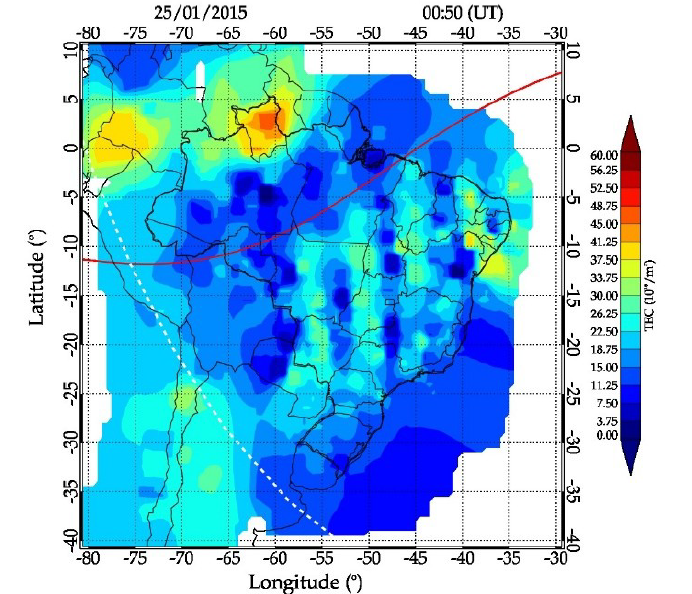

pip install opencv-contrib-python

pip install --upgrade pip

pip uninstall opencv-python --yes

pip install https://github.com/matplotlib/basemap/archive/master.zip

#### Not being able to automate everything, I manually created a folder for each of the time groups. Read from each folder, plot the TEC map of each file and save each group in different folders.

### From 2015/01/19-20:00 UT to 2015/01/20-06:00 UT:

In [17]:
import cv2
import glob

my_list = []
path = '/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/*.*'

for file in glob.glob(path): #iterate through each file
    print(file)
    a = cv2.imread(file) #read each file
    my_list.append(a) #create a list of text file
    
my_list[1]

/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150120_0350.txt
/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150120_0310.txt
/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150119_2250.txt
/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150119_2330.txt
/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150119_2040.txt
/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150120_0340.txt
/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150120_0600.txt
/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150120_0140.txt
/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150120_0510.txt
/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150119_2100.txt
/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150119_2350.txt
/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMA

In [11]:
import os
pathh = '/home/dorcas/Documents/Statistical Mechanics/StatList 2/Quest 2a'

# check whether the path exists
is_exist = os.path.exists(path)

if not is_exist:
    
    #create a new path:
    os.makedirs(pathh, exist_ok=False)


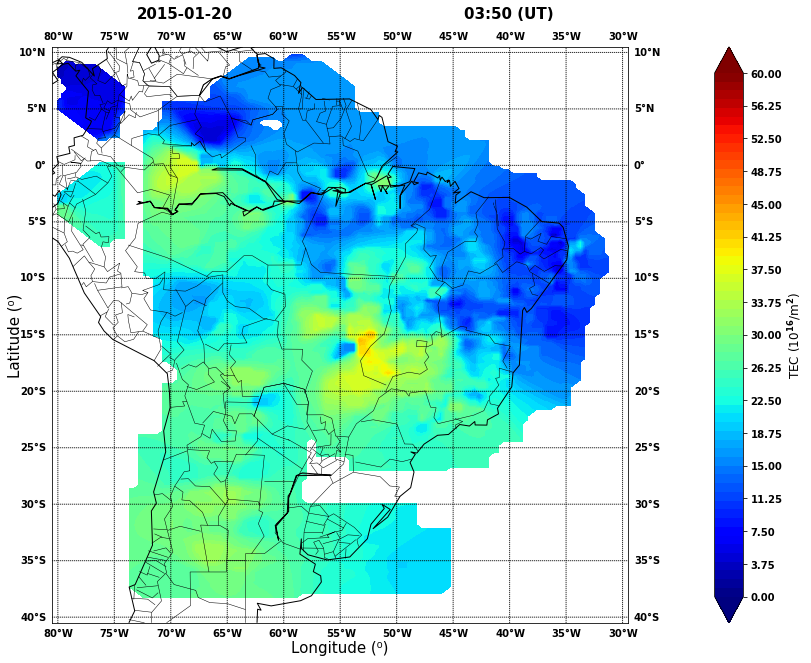

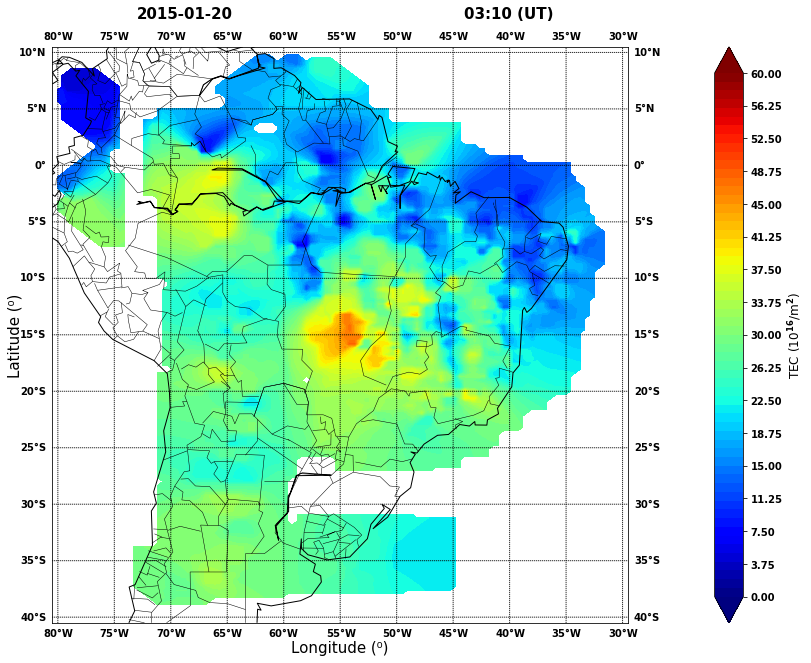

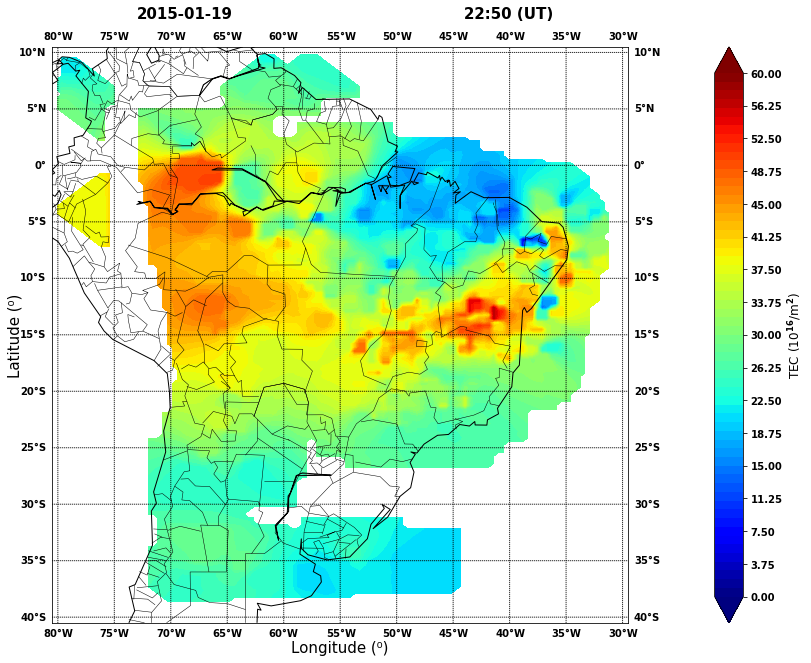

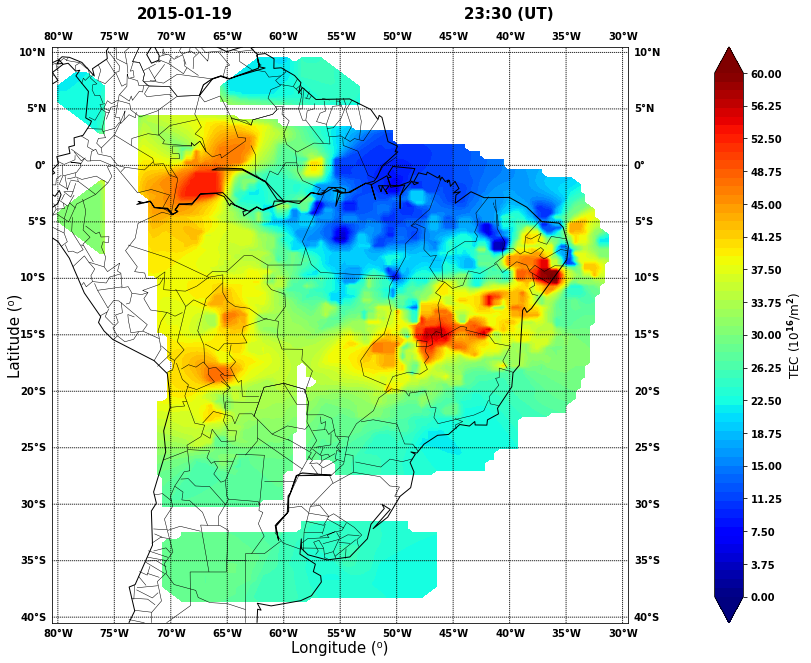

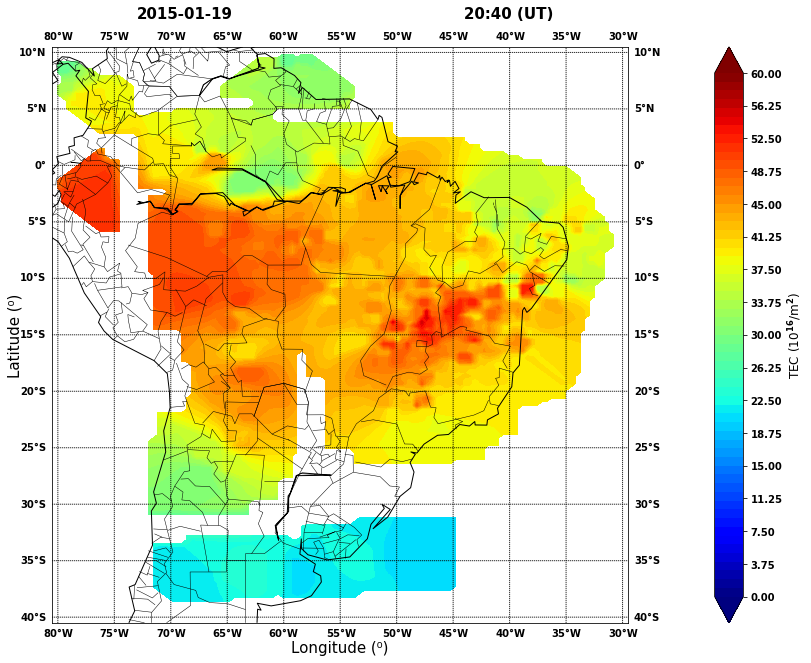

...

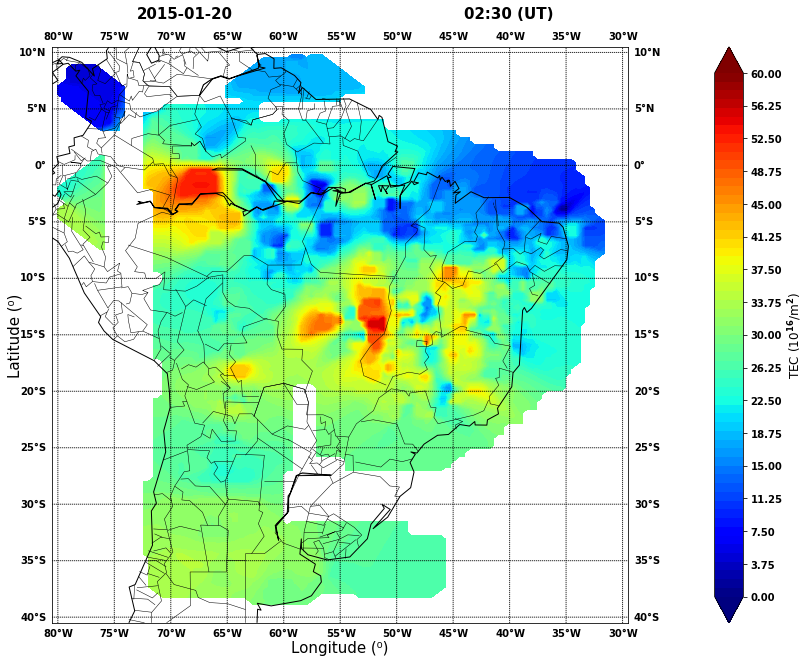

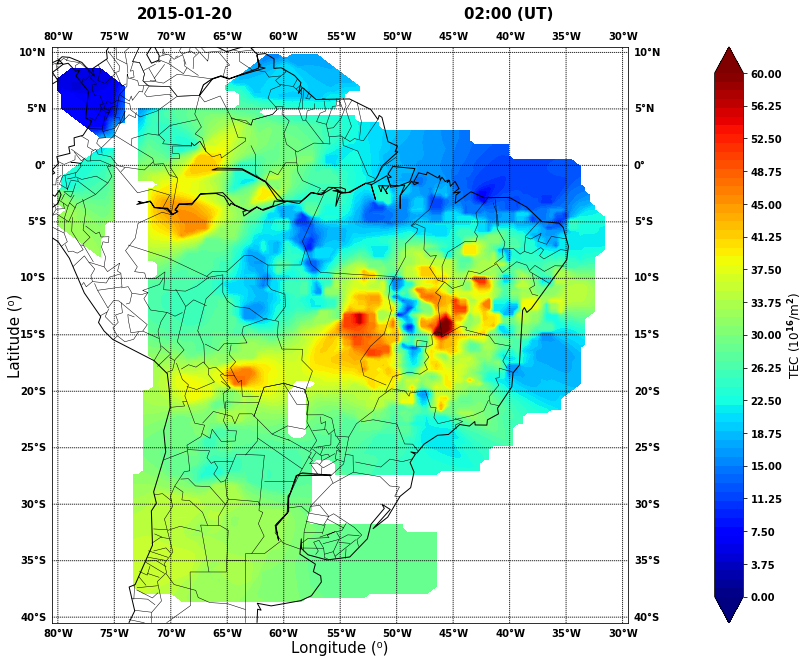

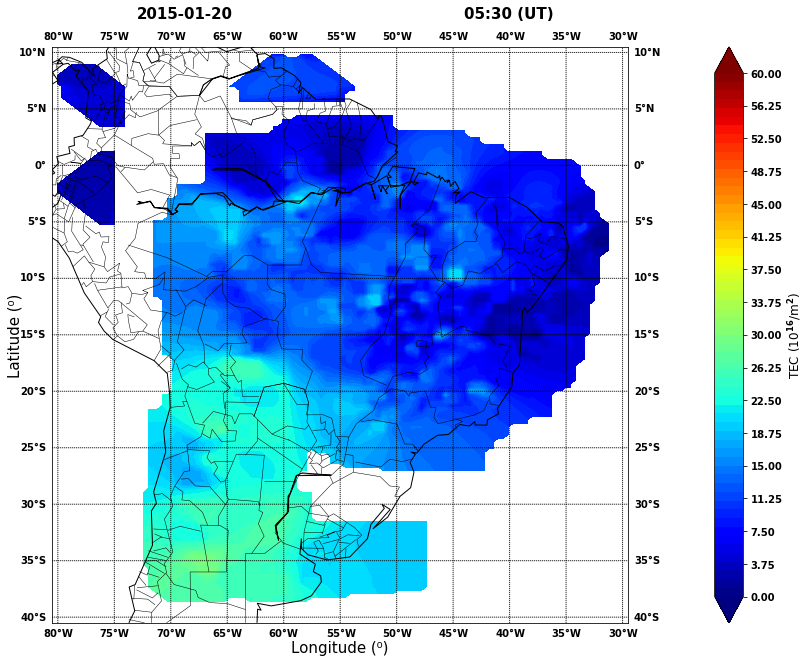

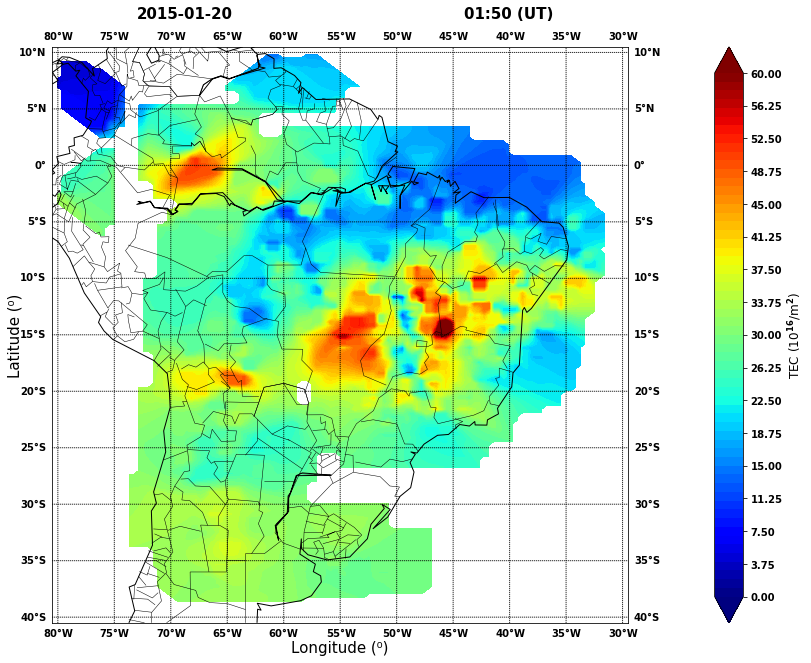

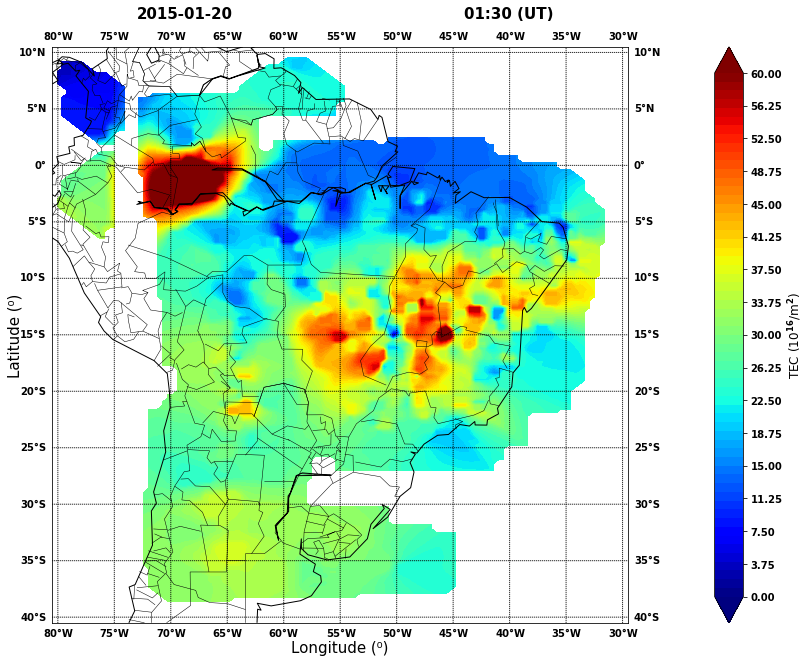

In [12]:
import os
#import the library opencv
import cv2
from glob import glob
import numpy as np
from matplotlib import cm
import matplotlib.pyplot as plt
path = '/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a'

from mpl_toolkits.basemap import Basemap

# find all the txt files in the dataset folder
inputs = []
for file in os.listdir("Q2a"):
    if file.endswith(".txt"):
        inputs.append(os.path.join(path, file))
        

# Read TECMAP files
k = 0
for txt_files in inputs:
    file = txt_files
    data_file = open(file, 'r')
    #data_file = data_file.read()
    #data_file 

    TEC = np.zeros((121, 160)) #Return a new array of 121,160, filled with zeros.

    j = 0
    for line in data_file:

        line = line.split(';') #each value is separated by ';'

        for i in range(0, 120):
            if float(line[i]) == -1.0:
                TEC[i, j] = np.nan          #set -1.0 values to be nan
            else:
                TEC[i, j] = float(line[i]) #

        j = j + 1

    TEC = np.transpose(TEC) #now (160,121)

    # Using Filename to be set as title
    bname = os.path.basename(file)
    bname = os.path.splitext(bname)
    sep = bname[0].split('_')
    date = sep[1][0:4]+'-'+sep[1][4:6]+'-'+sep[1][6:8]
    time = sep[2][0:2]+':'+sep[2][2:4]+' (UT)'

    # Textfont
    #plt.rc('text', usetex=True)
    #plt.rc('font', family='serif')

    # Map settings
    latitudes = np.arange(-40.5, 11., 0.5)
    longitudes = np.arange(-80.5, -29., 0.5)
    dlatitudes = [latitudes[0], latitudes[len(latitudes)-1]]
    dlongitudes = [longitudes[0], longitudes[len(longitudes)-1]]
    dlat = 5

    # create figure and axes instances
    fig = plt.figure(figsize=(12,10))
    ax = fig.add_axes([0.1, 0.1, 0.8, 0.8])

    # CREATE EQUIDISTANT CYLINDRICAL PROJECTION BASEMAP INSTANCE
    m = Basemap(projection='cyl', llcrnrlat=dlatitudes[0], urcrnrlat=dlatitudes[1],\
                llcrnrlon=dlongitudes[0], urcrnrlon=dlongitudes[1], resolution='c')

    # DRAW COASTLINES, STATE AND COUNTRY BOUNDARIES, EDGE OF MAP
    m.drawcoastlines()
    m.drawcountries()
    m.drawstates()

    # DRAW PARALLELS
    parallels = np.arange(-60., 20., dlat)
    m.drawparallels(parallels, labels=[1, 1, 0, 0], fontsize=10) #the 1,1, det tick location on both sides

    # DRAW MERIDIANS
    meridians = np.arange(-90., -25., dlat)
    m.drawmeridians(meridians, labels=[0, 0, 1, 1], fontsize=10)

    # CONTOUR PLOT
    y = TEC.shape[0]; x = TEC.shape[1]
    #x = 121, y = 160
    lons, lats = m.makegrid(x, y) 
    lon, lat = m(lons, lats)

    # to create filled contour plots.
    cs = m.contourf(lon, lat, TEC, np.arange(0, 61), extend='both', cmap=cm.jet)
    #plt.axis('off')

    # COLORBAR
    cbar = m.colorbar(cs, location='right', pad="15%", ticks=np.arange(0, 70, 3.75))
    cbar.set_label(r'TEC (10$^{16}$/m$^{2}$)', fontsize=12)

    # PLOT LABLES
    plt.xlabel('Longitude (⁰)', fontsize=15, labelpad=18.)
    plt.ylabel('Latitude (⁰)', fontsize=15, labelpad=30.)

    plt.text(-73., 13, date, fontsize=15)
    plt.text(-44., 13, time, fontsize=15)
    #looping the file name
    filename = '/home/dorcas/Documents/Statistical Mechanics/StatList 2/Quest 2a/' \
    + str(date) + str('_') + str(time) +'.png'
    plt.savefig(filename, bbox_inches='tight')
    plt.show()
# Close object and discard memory buffer
data_file.close()

### 3. From the TEC matrix of the map below, select the TEC values under the white lines and then plot those values in the form of colored line plots according to the color table of the TEC map shown.

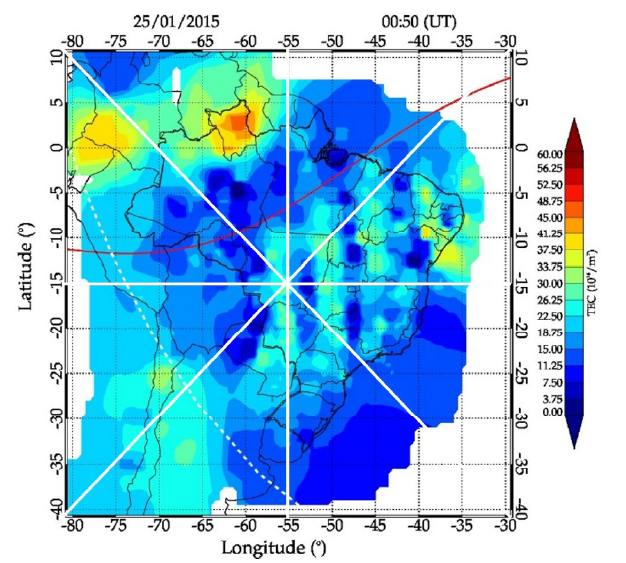

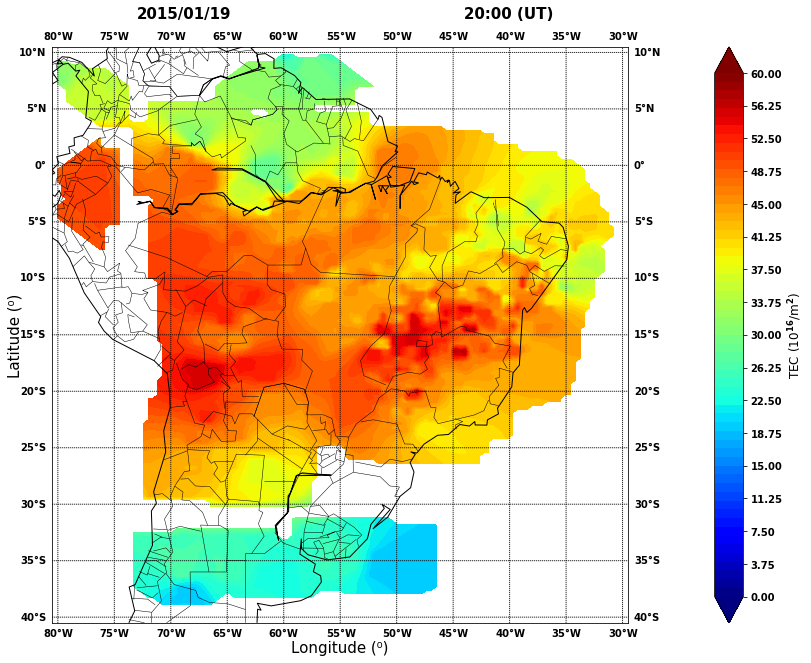

In [52]:
import os
#import the library opencv
import cv2
import numpy as np
from matplotlib import cm
import matplotlib.pyplot as plt

from mpl_toolkits.basemap import Basemap
        
# Read TECMAP file
file = '/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150119_2000.txt'
data_file = open(file, 'r')

TEC = np.zeros((121, 160)) #Return a new array of 121,160, filled with zeros.

j = 0
for line in data_file:
    
    line = line.split(';') #each value is separated by ';'
    
    for i in range(0, 120):
        if float(line[i]) == -1.0:
            TEC[i, j] = np.nan          #set -1.0 values to be nan
        else:
            TEC[i, j] = float(line[i]) #
            
    j = j + 1
    
TEC = np.transpose(TEC) #now (160,121)

# Using Filename to be set as title
bname = os.path.basename(file)
bname = os.path.splitext(bname)
sep = bname[0].split('_')
date = sep[1][0:4]+'/'+sep[1][4:6]+'/'+sep[1][6:8]
time = sep[2][0:2]+':'+sep[2][2:4]+' (UT)'

# Textfont
#plt.rc('text', usetex=True)
#plt.rc('font', family='serif')

# Map settings
latitudes = np.arange(-40.5, 11., 0.5)
longitudes = np.arange(-80.5, -29., 0.5)
dlatitudes = [latitudes[0], latitudes[len(latitudes)-1]]
dlongitudes = [longitudes[0], longitudes[len(longitudes)-1]]
dlat = 5

# create figure and axes instances
fig = plt.figure(figsize=(12,10))
ax = fig.add_axes([0.1, 0.1, 0.8, 0.8])

# CREATE EQUIDISTANT CYLINDRICAL PROJECTION BASEMAP INSTANCE
m = Basemap(projection='cyl', llcrnrlat=dlatitudes[0], urcrnrlat=dlatitudes[1],\
            llcrnrlon=dlongitudes[0], urcrnrlon=dlongitudes[1], resolution='c')

# DRAW COASTLINES, STATE AND COUNTRY BOUNDARIES, EDGE OF MAP
m.drawcoastlines()
m.drawcountries()
m.drawstates()

# DRAW PARALLELS
parallels = np.arange(-60., 20., dlat)
m.drawparallels(parallels, labels=[1, 1, 0, 0], fontsize=10) #the 1,1, det tick location on both sides

# DRAW MERIDIANS
meridians = np.arange(-90., -25., dlat)
m.drawmeridians(meridians, labels=[0, 0, 1, 1], fontsize=10)

# CONTOUR PLOT
y = TEC.shape[0]; x = TEC.shape[1]
#x = 121, y = 160
lons, lats = m.makegrid(x, y) 
lon, lat = m(lons, lats)

# to create filled contour plots.
cs = m.contourf(lon, lat, TEC, np.arange(0, 61), extend='both', cmap=cm.jet)
#plt.axis('off')

# COLORBAR
cbar = m.colorbar(cs, location='right', pad="15%", ticks=np.arange(0, 70, 3.75))
cbar.set_label(r'TEC (10$^{16}$/m$^{2}$)', fontsize=12)

# PLOT LABLES
plt.xlabel('Longitude (⁰)', fontsize=15, labelpad=18.)
plt.ylabel('Latitude (⁰)', fontsize=15, labelpad=30.)

plt.text(-73., 13, date, fontsize=15)
plt.text(-44., 13, time, fontsize=15)
plt.show()
# Close object and discard memory buffer
data_file.close()

In [53]:
import os
import pandas as pd
#import the library opencv
import cv2
import numpy as np
from matplotlib import cm
import matplotlib.pyplot as plt

from mpl_toolkits.basemap import Basemap
        
# Read TECMAP file
file = '/home/dorcas/Documents/Statistical Mechanics/StatList 2/Q2a/TECMAP_20150119_2000.txt'
data_file = pd.read_csv(file, sep=';', header=None)
data_file=data_file.replace(-1, np.nan)
data_file

,0,1,2,3,4,5,6,7,8,9,...,111,112,113,114,115,116,117,118,119,120
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
155,NaN,NaN,30.8151,31.4085,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
156,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
157,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
158,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


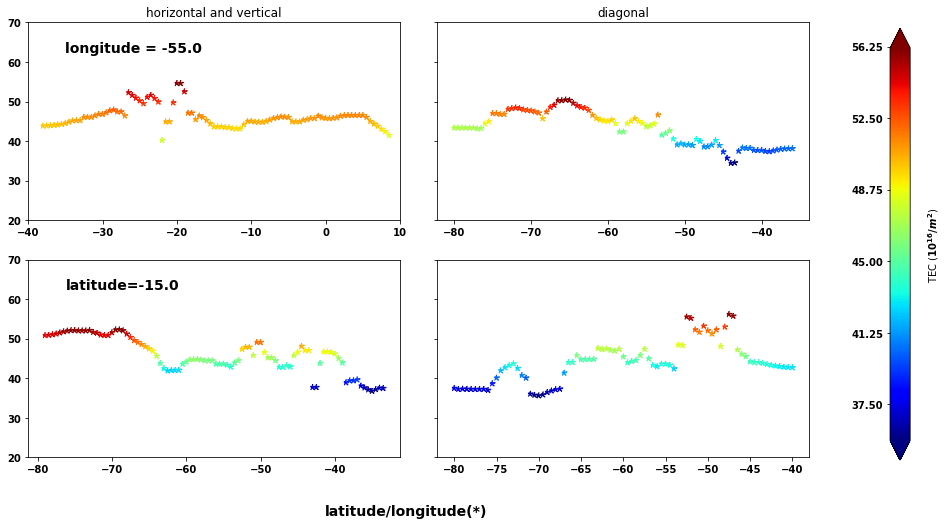

In [54]:
rows, columns = data_file.values.shape
# row=160; columns=121
data_file.index =  np.arange(0, rows)*0.5 - 60
data_file.columns= np.arange(0, columns)*0.5 - 90

lon = data_file.columns.values,
lat = data_file.index.values

# lon = np.arange(-90., -30., dlat)
# lat = np.arange(-60., 20., dlat)

startlat, endlat = -40, 10
startlon, endlon = -80, -30

horizontal = data_file.loc[data_file.index == (endlat + startlat)/2, :].T

vertical = data_file.loc[:, data_file.columns == (endlon + startlon)/2]

diagonal_1 = []

for i, j in zip(np.arange(startlon, endlon, 0.5), np.arange(startlat, endlat, 0.5)):
    data = data_file.loc[data_file.index == j, data_file.columns ==i]
    diagonal_1.append(data.values[0][0])
    
diagonal_2 = []

for i, j in zip(np.arange(startlon, endlon, 0.5), np.arange(-endlat, -startlat, 0.5)):
    data = data_file.loc[data_file.index == -j, data_file.columns ==i]
    diagonal_2.append(data.values[0][0])
    
    
fig, ax = plt. subplots(figsize=(14,8), nrows = 2, ncols = 2, sharey = True)
plt.subplots_adjust(wspace = 0.1, hspace=0.2)

args = dict(cmap='jet', marker = '*', linestyle = '--')

ax[0,0].scatter(vertical.index, vertical.values, zorder=1, c=vertical.values, **args)

ax[0,0].set(xlim=[startlat, endlat], title='horizontal and vertical')

ax[1,0].scatter(horizontal.index, horizontal.values, c=horizontal.values, **args)

x=np.arange(startlon, endlon, 0.5)

ax[0,1].scatter(x, diagonal_1, c=diagonal_1, **args)

img=ax[1,1].scatter(x,diagonal_2,c=diagonal_2, **args)

v=np.arange(0, 63.75, 3.75)

# color bar
cbar_ax=fig.add_axes([0.98, 0.12, 0.02, 0.75])

cb=fig.colorbar(img, cax = cbar_ax, ticks=v, ticklocation='left', extend='both')

cb.set_label(r'TEC ($10^{16}/m^2$)', labelpad=-90, y = 0.50)
ax[0, 1].set(title = 'diagonal', ylim=[20,70])
ax[0,0].text(0.1, 0.85, 'longitude = {}'.format((endlon+startlon)/2), rotation_mode='anchor',\
             fontsize=14, transform=ax[0,0].transAxes)

ax[1,0].text(0.1, 0.85, 'latitude={}'.format((endlat+startlat)/2), rotation_mode='anchor',\
             fontsize=14, transform=ax[1,0].transAxes)

fig.text(0.5, 0.02, 'latitude/longitude(*)', va='bottom', ha = 'center', fontsize = 14)
plt.savefig('selected TEC values ', bbox_inches='tight')
plt.show()

### 4. From the TEC matrices for the range between TEC 2015/12/24-20:00 UT and 2015/12/25-06:00 UT, select the TEC values only for LAT = 25 S and then plot those values in the form of a contour plot, TEC(yaxis) x time (x-axis. 
### Use the same color table as the TEC maps.

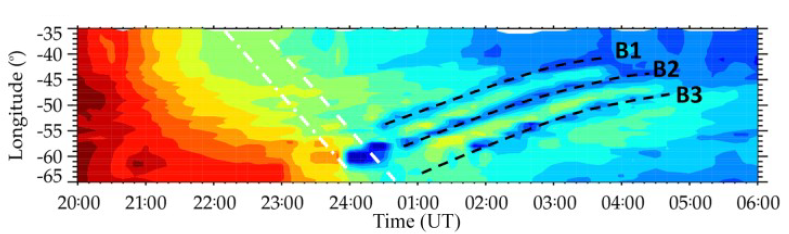

TECMAP_20131224_2130.txt TECMAP_20131225_1100.txt


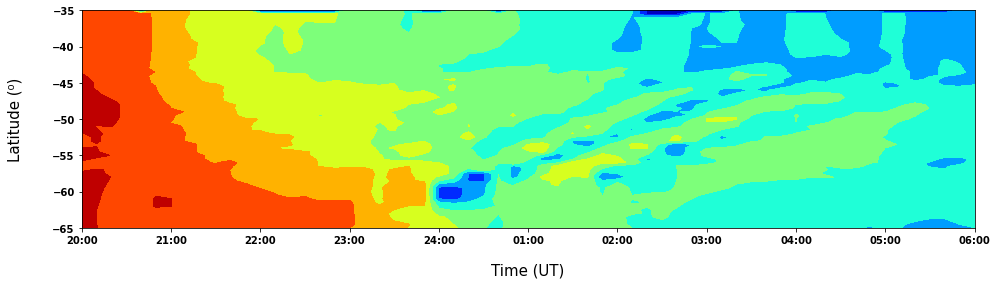

In [56]:
import os
import fnmatch
import numpy as np
import pandas as pd
from matplotlib import cm
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap

# Paths
cwd = os.getcwd()
path_in = '/home/dorcas/Documents/Statistical Mechanics/StatList 2/List2/'
path_out = cwd + '/Question4 plot'
#print(path_out)

# create folder
if not os.path.exists(path_out):
    os.makedirs(path_out)

# search file
find1 = fnmatch.filter(os.listdir(path_in), 'TECMAP_20131224_*.txt')
find2 = fnmatch.filter(os.listdir(path_in), 'TECMAP_20131225_*.txt')
find = find1 + find2
# print(find)

# basename
basename = os.path.splitext(find[0])
#print(basename)

basename = find[0][7:-9]
#print(basename)

# pick the days
day = []
for i in find:
    day.append(int(i[-11:-9]))
    
#print('days',day)
# # print('days', [int(i[-11:-9]) for i in find])

# pick the hours
hour = []
for i in find:
    hour.append(int(i[-8:-6]))    
#print('hours',hour)

#pick the minutes
minute = []
for i in find:
    minute.append(int(i[-6:-4]))
#print(minute)

# create a list of tuples containing day, hour and minutes
day_hour = list(zip(day,hour,minute))
# print('day_hour is \n', day_hour)

# find specific file
id1 = [i for i, (day, hour, minute) in enumerate(day_hour) if (hour>=20) and (day==24)]
id2 = [i for i, (day, hour, minute) in enumerate(day_hour) if (hour<=5) and (day==25)]
# to remove 06:10, 06:20, 06:30, 06:40 and 06:50
id3 = [i for i, (day, hour, minute) in enumerate(day_hour) if (hour==6) and (day==25) and (minute<10)]
#print('id1 \n', id1) # print('id3 \n', id3)
id = id1 + id2 + id3
#print(len(id)) # print('id is \n', id)
print(find[id[0]], find[287])

id = np.array(id)
# id = np.where(np.asarray(hour) >= 20.)
# id = id[0]
#print(id) # print(find[id[0]])

data_file = [find[i] for i in id]
data_file.sort()
# print(data_file)

lat = np.arange(-60, 20, 0.5)
lon = np.arange(-90, -29.5, 0.5)

lat25 = np.where(lat == -25.)[0][0]

# READ DATA

for i in range(0, len(data_file)):
    data = pd.read_csv(path_in+data_file[i], delimiter=';', header=None)
    if i == 0:
        df = pd.DataFrame(data.loc[lat25, :])
    else:
        # concatenating df3 and df4 along columns
        df = pd.concat([df, data.loc[lat25, :]], axis=1)

fig, ax = plt.subplots(figsize=(16,4))

#PLOT
time = np.linspace(0, 24, 61)

xv, yv = np.meshgrid(time, lon)
#print(df.shape, xv.shape, yv.shape)

plt.contourf(xv, yv, df, cmap=cm.jet)

#to set the x ticks
ax.set_xticks(np.linspace(0, 24, 11))
labels = [item.get_text() for item in ax.get_xticklabels()]
labels =['20:00', '21:00', '22:00', '23:00', '24:00', '01:00', '02:00', '03:00', '04:00', '05:00', '06:00']
ax.set_xticklabels(labels)

ax.set_ylim(-65,-35)
# PLOT LABLES
plt.xlabel('Time (UT)', fontsize=15, labelpad=18.)
plt.ylabel('Latitude (⁰)', fontsize=15, labelpad=30.)

plt.savefig('selected TEC values at lat25', bbox_inches='tight')
plt.show()
fig.tight_layout()

### 5. The doctoral student Prosper K. Nyassor has associated the occurrence of lightnings to the occurrence of a concentric gravity wave (see graph below). 
### The colored circles represent the occurrence of lightning, while the dashed circles represent the wavefront of gravity waves. 
### The colors and the radius of the circles that represent the lightnings are set using the “Peak current” parameter.
### Higher current peaks will have larger radius and more intense colors. Make a program to reproduce the graphic below

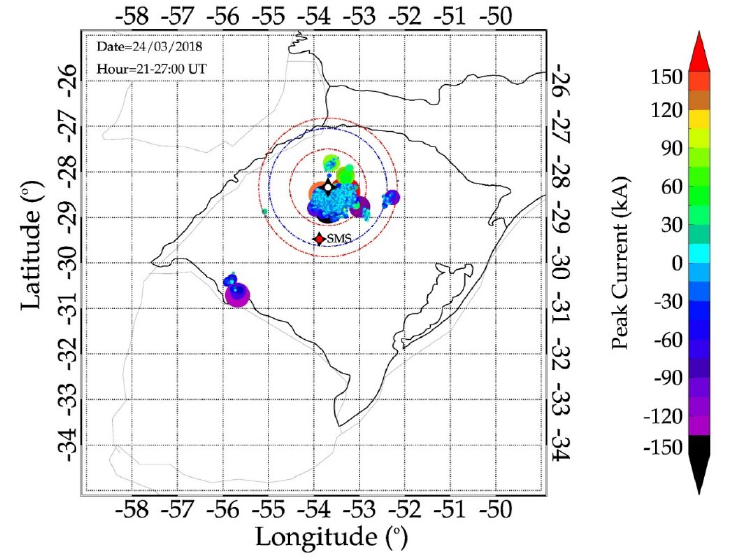

In [57]:
header = ['Latitude', 'Longitude', 'Peak Current(kA)', 'Index']

In [58]:
import pandas as pd
df2 = pd.read_csv('Q5 test.txt', sep='\s+', names=header)
df2 = pd.DataFrame(df2)
df2

,Latitude,Longitude,Peak Current(kA),Index
0,-28.7512,-53.5482,102,0
1,-28.6523,-53.5046,5,1
2,-28.8114,-53.5014,-5,1
3,-28.8812,-53.5193,-9,1
4,-28.6448,-53.5070,-5,1
...,...,...,...,...
2026,-30.4163,-55.4396,11,0
2027,-30.5263,-55.5022,10,0
2028,-30.4150,-55.2962,18,0
2029,-30.4775,-55.7861,-16,0


17-nov-21 00:59:33: /home/dorcas/pyspedas/lib/python3.8/site-packages/matplotlib/collections.py:1003: RuntimeWarning: invalid value encountered in sqrt
  scale = np.sqrt(self._sizes) * dpi / 72.0 * self._factor



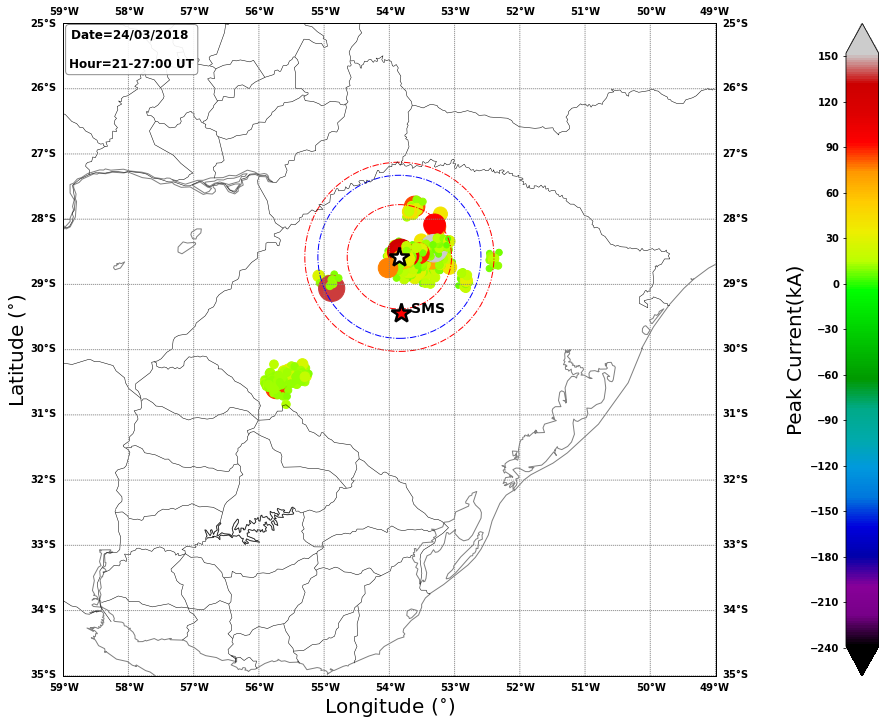

In [59]:
%matplotlib inline
import numpy as np
from matplotlib import cm
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap

fig, ax = plt.subplots(figsize=(18,12))

# Center of Concentric Gravity Waves
Lon_CG = -53.846
Lat_CG = -28.577
# SMS
Lat_SMS = -29.44
Lon_SMS = -53.82

m = Basemap(projection='cyl',llcrnrlat=-35,urcrnrlat=-25, llcrnrlon=-59,urcrnrlon=-49,resolution='i')
# m = Basemap(projection='cyl',llcrnrlat=-90,urcrnrlat=90,\
#             llcrnrlon=-180,urcrnrlon=180,resolution='c', lat_0 = -53.846, lon_0 = -28.577)
m.drawcoastlines(color='grey')
m.drawcountries()
m.drawstates()

#size of marker
s1=5*df2['Peak Current(kA)']

# plotting the points
cmm = plt.scatter(df2['Longitude'], df2['Latitude'], c=df2['Peak Current(kA)'], 
                  s=s1, cmap='nipy_spectral')

# draw parallels and meridians.
m.drawparallels(np.arange(-90.,91.,1.), color='gray', labels=[1,1,0,0]) #the latitudinal lines
m.drawmeridians(np.arange(-180.,181.,1.), color='gray', labels=[0,0,1,1]) #the longitudinal lines
m.drawmapboundary()

# create the star labels
m.plot(Lon_SMS, Lat_SMS, marker='*', color='r', markersize=20, mec = 'k', markeredgewidth=2.5)
m.plot(Lon_CG,  Lat_CG,  marker='*', color='w', markersize=20, mec = 'k', markeredgewidth=2.5)
ax.text(Lon_SMS+0.15, Lat_SMS, 'SMS', fontsize = 14, color = 'black')

# COLORBAR; range is set according to the max and min of peak current
cbar = m.colorbar(cmm, location='right', pad="20%", ticks=np.arange(-240, 151, 30),\
                  ticklocation='left', extend = 'both')
cbar.set_label('Peak Current(kA)', fontsize=20)

# text on the map
bbox_props = dict(boxstyle="round", fc="w", ec="0.5", alpha=0.9)
ax.text(-57.95, -25.4, "Date=24/03/2018 \n\nHour=21-27:00 UT", ha="center", va="center", 
        size=12, bbox=bbox_props)

# the circles
circle1 = plt.Circle((Lon_CG, Lat_CG), 0.8,  color='r',  linestyle='-.', fill=False)
circle2 = plt.Circle((Lon_CG, Lat_CG), 1.25, color='b', linestyle='-.', fill=False)
circle3 = plt.Circle((Lon_CG, Lat_CG), 1.45, color='r', linestyle='-.', fill=False)
ax.add_patch(circle1)
ax.add_patch(circle2)
ax.add_patch(circle3)

# axis label
plt.xlabel('Longitude ($^{\\circ}$)', fontsize=20, labelpad=20.)
plt.ylabel('Latitude ($^{\\circ}$)', fontsize=20, labelpad=35.)

plt.savefig('occurrence of lightnings and concentric gravity wave.png', bbox_inches='tight')
plt.show()

fig.tight_layout()

### 6. On the Embrace website it is possible to have access to a wide variety of data related to Space Weather, among them are the data from Magnetometers. 
### Make a script to plot the magnetometer data just like the example below

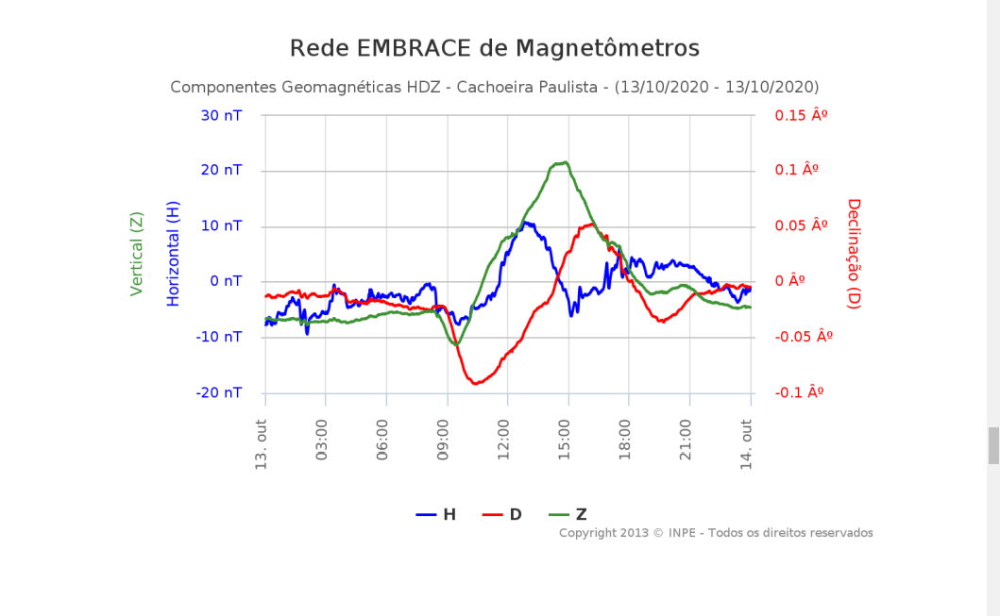

In [60]:
df3 = pd.read_csv('Q6.txt', sep='\s+', header=None, names=['Day', 'Month', 'Year', 'Hour', 'Minute', 'D(Deg)', 'H(nT)', 'Z(nT)', 'I(Deg)', 'F(nT)'])
df3 = pd.DataFrame(df3)
df3

,Day,Month,Year,Hour,Minute,D(Deg),H(nT),Z(nT),I(Deg),F(nT)
0,13,10,2020,0,0,-21.8256,18209.8,-14147.1,-37.8433,23059.4
1,13,10,2020,0,1,-21.8256,18209.9,-14147.1,-37.8431,23059.5
2,13,10,2020,0,2,-21.8253,18210.4,-14147.0,-37.8423,23059.9
3,13,10,2020,0,3,-21.8254,18210.1,-14147.1,-37.8428,23059.6
4,13,10,2020,0,4,-21.8252,18209.9,-14147.1,-37.8432,23059.6
...,...,...,...,...,...,...,...,...,...,...
1434,13,10,2020,23,54,-21.8198,18213.8,-14145.4,-37.8338,23061.5
1435,13,10,2020,23,55,-21.8201,18213.8,-14145.3,-37.8338,23061.5
1436,13,10,2020,23,56,-21.8200,18213.3,-14145.4,-37.8347,23061.1
1437,13,10,2020,23,57,-21.8198,18213.6,-14145.4,-37.8344,23061.4


In [61]:
#create a new column for date+time
df3 = df3.assign(Date_Hour=lambda df3: pd.to_datetime(df3[['Year', 'Month', 'Day', 'Hour', 'Minute']]))
df3

,Day,Month,Year,Hour,Minute,D(Deg),H(nT),Z(nT),I(Deg),F(nT),Date_Hour
0,13,10,2020,0,0,-21.8256,18209.8,-14147.1,-37.8433,23059.4,2020-10-13 00:00:00
1,13,10,2020,0,1,-21.8256,18209.9,-14147.1,-37.8431,23059.5,2020-10-13 00:01:00
2,13,10,2020,0,2,-21.8253,18210.4,-14147.0,-37.8423,23059.9,2020-10-13 00:02:00
3,13,10,2020,0,3,-21.8254,18210.1,-14147.1,-37.8428,23059.6,2020-10-13 00:03:00
4,13,10,2020,0,4,-21.8252,18209.9,-14147.1,-37.8432,23059.6,2020-10-13 00:04:00
...,...,...,...,...,...,...,...,...,...,...,...
1434,13,10,2020,23,54,-21.8198,18213.8,-14145.4,-37.8338,23061.5,2020-10-13 23:54:00
1435,13,10,2020,23,55,-21.8201,18213.8,-14145.3,-37.8338,23061.5,2020-10-13 23:55:00
1436,13,10,2020,23,56,-21.8200,18213.3,-14145.4,-37.8347,23061.1,2020-10-13 23:56:00
1437,13,10,2020,23,57,-21.8198,18213.6,-14145.4,-37.8344,23061.4,2020-10-13 23:57:00


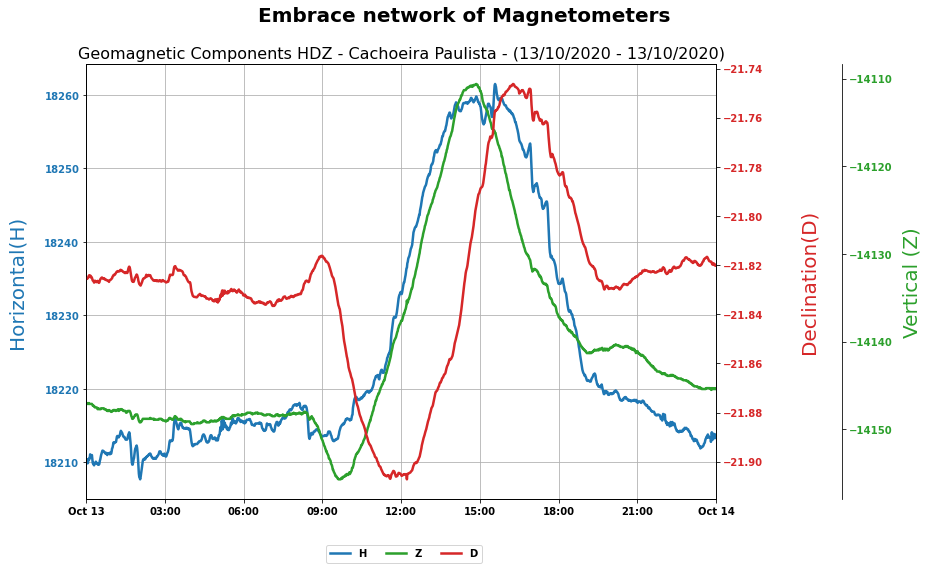

In [64]:
fig, ax1 = plt.subplots(1,1, figsize=(14,8))
fig.subplots_adjust(right=0.75)

plt.rcParams['figure.figsize'] = [8,6]
plt.rcParams["font.weight"] = "bold"

#plot
color = 'tab:blue'
plot1 = ax1.plot(df3['H(nT)'], label='H', linewidth=2.5, color=color)
ax1.set_ylabel('Horizontal(H)', color=color, fontsize=20, labelpad=18.)
ax1.tick_params(axis='y', labelcolor=color)
fig.suptitle('Embrace network of Magnetometers', fontsize=20, weight='bold')
ax1.set_title('Geomagnetic Components HDZ - Cachoeira Paulista - \
(13/10/2020 - 13/10/2020)', size=16)

ax2 = ax1.twinx()

# Offset the right spine of twin2.  The ticks and label have already been
# placed on the right by twinx above.
ax2.spines.right.set_position(("axes", 1.2))

color = 'tab:green'
plot2 = ax2.plot(df3['Z(nT)'], label='Z', linewidth=2.5, color=color)
ax2.set_ylabel('Vertical (Z)', color=color, fontsize=20, labelpad=10.)
ax2.tick_params(axis='y', labelcolor=color)

ax3 = ax1.twinx()

color = 'tab:red'
plot3 = ax3.plot(df3['D(Deg)'], label='D', linewidth=2.5, color=color)
ax3.set_ylabel('Declination(D)', color=color, fontsize=20, labelpad=36.)
ax3.tick_params(axis='y', labelcolor=color)

#to set the x ticks
ax1.set_xticks(np.linspace(0, 1436, 9))
labels = [item.get_text() for item in ax1.get_xticklabels()]
labels =['Oct 13', '03:00', '06:00', '09:00', '12:00', '15:00', '18:00', '21:00', 'Oct 14']

ax1.set_xticklabels(labels)

ax1.grid()
ax1.set_xlim(0,1436)
fig.legend(bbox_to_anchor=[0.44,0.03], loc='center', ncol=3)
plt.savefig('Geomagnetic Components HDZ - Cachoeira Paulista.png', bbox_inches='tight')
# fig.legend(loc=8)
#fig.tight_layout()
plt.show()

### 7. A widely used parameter to measure the intensity of convection clouds is the Cloud-Top Brightness Temperature. 
### Dr. Cosme O.A.B. Figueiredo has used these convective activity data to associate the generation with mediumscale traveling ionospheric disturbance (MSTID).
### Make a program to plot the Cloud-Top Brightness Temperature data just like the example below

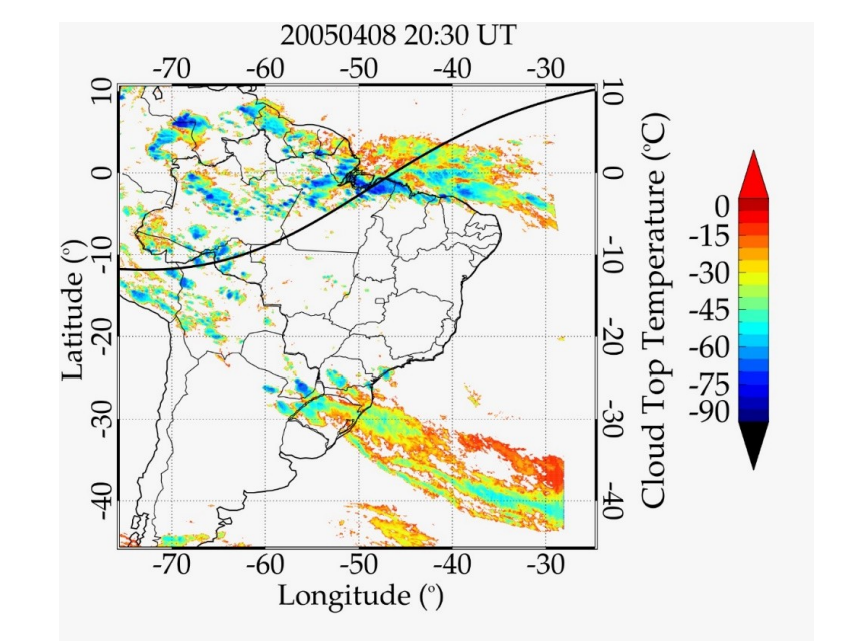

In [65]:
import pandas as pd
df4 = pd.read_csv('Q7_1.txt', sep='\s+', header=None)
#df4 = pd.DataFrame(df4)
df4


,0,1,2,3,4,5,6,7,8,9,...,1790,1791,1792,1793,1794,1795,1796,1797,1798,1799
0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-273.13,NaN,NaN
1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-273.13,NaN
3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1795,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,-273.13,-273.13
1796,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1797,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1798,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,...,-273.13,NaN,NaN,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13,-273.13


In [66]:
df4.index = np.genfromtxt('Q7_2.txt', delimiter='')
df4.columns = np.genfromtxt('Q7_3.txt', delimiter='')
df4 = df4.replace(-273.13, np.nan)
df4

,-100.00,-99.96,-99.92,-99.88,-99.84,-99.80,-99.76,-99.72,-99.68,-99.64,...,-28.40,-28.36,-28.32,-28.28,-28.24,-28.20,-28.16,-28.12,-28.08,-28.04
21.96,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21.92,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21.88,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21.84,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
21.80,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
-49.84,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
-49.88,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
-49.92,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
-49.96,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


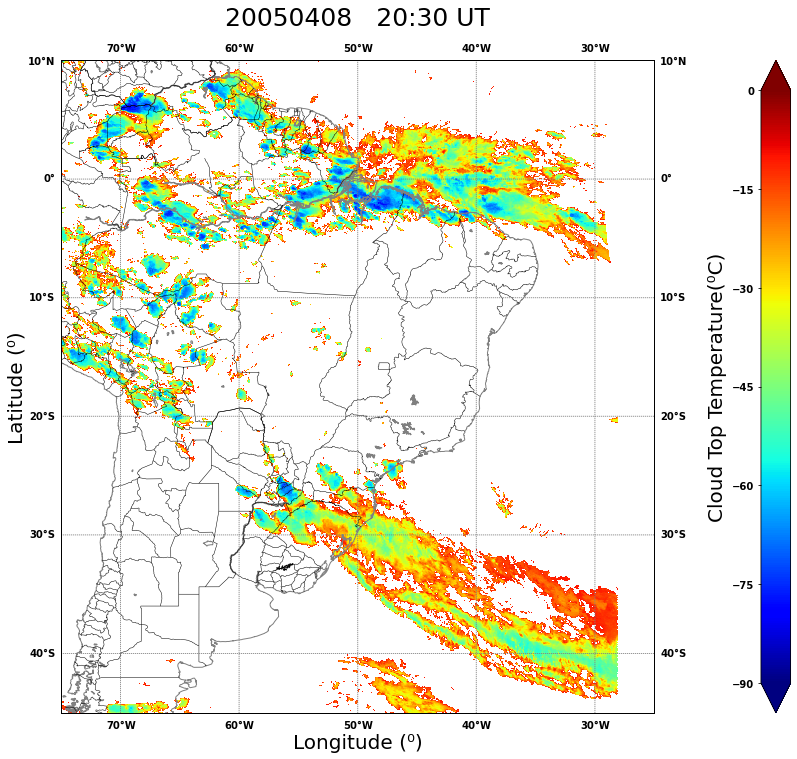

In [67]:
%matplotlib inline
import numpy as np
from matplotlib import cm
import matplotlib.pyplot as plt
from mpl_toolkits.basemap import Basemap

fig, ax = plt.subplots(figsize=(18,12))

m = Basemap(projection='cyl',llcrnrlat=-45,urcrnrlat=+10, llcrnrlon=-75,urcrnrlon=-25,resolution='i')

m.drawcoastlines(color='grey')
m.drawcountries()
m.drawstates()

# draw parallels and meridians.
m.drawparallels(np.arange(-90.,91.,10.), color='gray', labels=[1,1,0,0]) #the latitudinal lines
m.drawmeridians(np.arange(-180.,181.,10.), color='gray', labels=[0,0,1,1]) #the longitudinal lines
m.drawmapboundary()

m2 = ax.pcolormesh(df4.columns, df4.index, df4.values, cmap= 'jet', vmin=-90, vmax=0, shading='auto')

# COLORBAR
cbar = m.colorbar(m2, location='right', pad="18%", ticks=np.arange(0, -95, -15),\
                  ticklocation='left', extend='both')
cbar.set_label('Cloud Top Temperature(⁰C)', fontsize=20)

# PLOT LABLES
plt.xlabel('Longitude (⁰)', fontsize=20, labelpad=20.)
plt.ylabel('Latitude (⁰)',  fontsize=20, labelpad=35.)
ax.set_title('20050408   20:30 UT', size=25, pad=35.)

plt.savefig('Cloud-Top Brightness Temperature data.png', bbox_inches='tight')
plt.show()

### 8. From ionossonde data, make a script to output a contour plot of Height vs Time, where reflection frequency should be your z component

pip install nbconvert